# **ES 114 Probability Lab Assignment - 6**

Name- Shardul Rakesh Junagade

Roll No- 23110297

# **Image Binarization using Otsu's Threshold**

In this assignment, I have implemented Otsu's Thresholding algorithm for binarizing the given greyscale images with an intensity range of [0,255]. The algorithm is applied to the provided images in the first part of the notebook. In the later part of the notebook, I add Gaussian noise to the given images with different variances and apply the same Otsu's thresholding algorithm to observe the effects of noise on the binarization process. The results are analyzed and compared to understand the impact of noise on the thresholding technique.

## Importing Libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from IPython.display import Javascript
# from google.colab.patches import cv2_imshow

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import os

# Create directory if it does not exist
if not os.path.exists("Saved Results"):
    os.makedirs("Saved Results")

## Helper Functions

In [3]:
# Function defined to calculate the image histogram of any given iamge
def calculate_histogram(img,L=256):
  histogram=np.zeros(L, dtype=int)                # Initialize histogram array
  for x in range(img.shape[0]):
    for y in range(img.shape[1]):
      pixel_value= img[x][y].astype('int8')       # Find the intensity value of pixel
      histogram[pixel_value]+=1                   # Increment the histogram value at the corresponding intensity level
  return histogram


# Function defined to plot the image histogram
def plot_histogram(histogram,label):
  plt.bar(np.arange(len(histogram)),histogram,label=label)
  plt.ylabel("Number of Pixels")
  plt.xlabel("Pixel Intensity")
  plt.legend()

## Reading and Displaying the Images

In [4]:
bookpage_1 = cv2.imread("./dataset/bookpage_1.jpeg", 0)
bookpage_2 = cv2.imread("./dataset/bookpage_2.jpeg", 0)
panther = cv2.imread("./dataset/panther.jpeg", 0)
tom = cv2.imread("./dataset/tom.jpeg", 0)

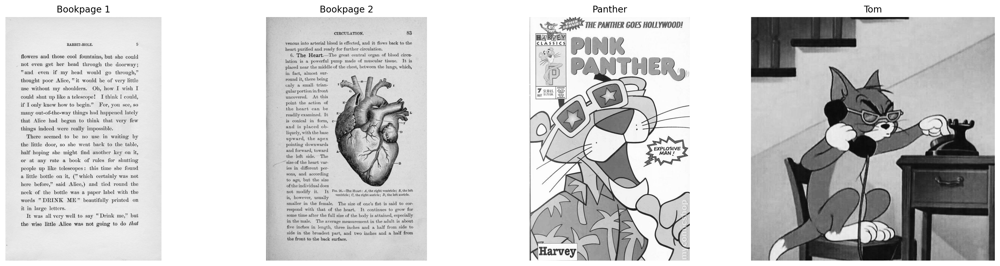

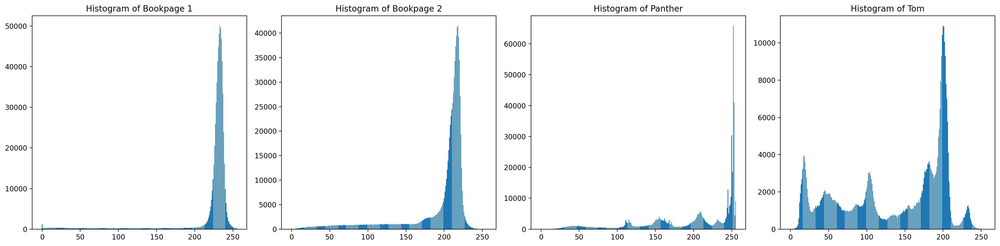

In [5]:
images = [bookpage_1, bookpage_2, panther, tom]
titles = ["Bookpage 1", "Bookpage 2", "Panther", "Tom"]

fig, axs = plt.subplots(1, 4, figsize=(20, 5))
for i, (image, title) in enumerate(zip(images, titles)):
    if image is not None and not image.size == 0:
        axs[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axs[i].set_title(title)
        axs[i].axis('off')
    else:
        axs[i].text(0.5, 0.5, 'Image not loaded', horizontalalignment='center', verticalalignment='center')
        axs[i].set_title(title)
        axs[i].axis('off')
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 4, figsize=(20, 5))
for i, (image, title) in enumerate(zip(images, titles)):
    if image is not None and not image.size == 0:
        axs[i].bar(np.arange(256), calculate_histogram(image))
        axs[i].set_title(f"Histogram of {title}")
    else:
        axs[i].text(0.5, 0.5, 'Image not loaded', horizontalalignment='center', verticalalignment='center')
        axs[i].set_title(f"Histogram of {title}")
plt.tight_layout()
plt.show()

# **Otsu's Thresholding Using Interclass Variance**

I have implemented Otsu's thresholding technique by maximizing the interclass variance. The objective is to determine the threshold $ t $ that separates pixel intensities into two classes, such that the interclass variance is maximized.

The formula for the interclass variance is:

$$
\sigma_b^2 = w_1 \cdot w_2 \cdot (\mu_1 - \mu_2)^2
$$

Where:
- $ w_1 $ and $ w_2 $ are the weights (probabilities) of the two classes, defined as:
  $$
  w_1 = \sum_{i=0}^{t} p(i), \quad w_2 = \sum_{i=t+1}^{L-1} p(i)
  $$
  Here, $ p(i) $ represents the probability of intensity $ i $ in the histogram, and $ L $ is the total number of intensity levels.
  
- $ \mu_1 $ and $ \mu_2 $ are the mean intensity values of the two classes, calculated as:
  $$
  \mu_1 = \frac{\sum_{i=0}^{t} i \cdot p(i)}{w_1}, \quad \mu_2 = \frac{\sum_{i=t+1}^{L-1} i \cdot p(i)}{w_2}
  $$

## Steps to Implement Otsu's Thresholding
1. **Compute the Histogram**:
   - Calculate the normalized histogram $ p(i) $, which represents the probability distribution of pixel intensities.

2. **Iterate Over Possible Thresholds**:
   - For each potential threshold $ t $ (ranging from 0 to $ L-1 $):
     - Compute $ w_1 $ and $ w_2 $, the probabilities of the two classes divided by the threshold $ t $.
     - Compute $ \mu_1 $ and $ \mu_2 $, the mean intensities of the respective classes.

3. **Calculate Interclass Variance**:
   - Use the formula $ \sigma_b^2 = w_1 \cdot w_2 \cdot (\mu_1 - \mu_2)^2 $ to calculate the interclass variance for each threshold $ t $.

4. **Find Optimal Threshold**:
   - Identify the threshold $ t $ that maximizes $ \sigma_b^2 $. This value is the optimal threshold for segmenting the image.

5. **Apply Threshold**:
   - Use the optimal threshold to segment the image, creating a binary image where pixels are classified into foreground or background based on their intensity relative to $ t $. All intensities below the threshold intensity are changed to 0 and the rest intensities are changed to 255.


In [6]:
# Function defined to calculate the class probabilities
def calculate_class_prob(histogram,t):
  w1=np.sum(histogram[:t+1])/np.sum(histogram)
  w2=np.sum(histogram[t+1:])/np.sum(histogram)
  return w1,w2


# Function defined to calculate the mean intensities of the two classes
def calculate_mean_intensities(histogram,t):
  mean1=np.sum(histogram[:t+1]*np.arange(t+1))/np.sum(histogram)
  mean2=np.sum(histogram[t+1:]*np.arange(t+1,256))/np.sum(histogram)
  w1,w2=calculate_class_prob(histogram,t)
  mean1 /= w1
  mean2 /= w2
  return mean1, mean2


# Function defined to calculate the Otsu's threshold
def otsu_threshold(image):
  histogram=calculate_histogram(image)
  max_interclass_variance=-1
  threshold_intensity=-1
  for t in range(np.min(image), np.max(image)):
    w1,w2=calculate_class_prob(histogram,t)
    mean1,mean2=calculate_mean_intensities(histogram,t)
    interclass_variance=w1*w2*(mean1-mean2)**2
    if interclass_variance>max_interclass_variance:
      max_interclass_variance=interclass_variance
      threshold_intensity=t
  return threshold_intensity


# Function defined to binarize the image
def binarize_image(image,threshold):
  binary_image=np.zeros_like(image)
  for i in range(image.shape[0]):
    for j in range(image.shape[1]):
      if image[i,j] < threshold:
        binary_image[i,j] = 0
      else:
        binary_image[i,j] = 255
  return binary_image

In [7]:
# Function defined to plot the binary image
def plot_binary_image(image, name, saev_img=True):
  histogram = calculate_histogram(image)
  threshold = otsu_threshold(image)
  binary_image = binarize_image(image, threshold)
  if saev_img:
    cv2.imwrite(f"./Saved Results/Binarized Image_{name}.png", binary_image)
  binary_histogram = calculate_histogram(binary_image)
  plt.figure(figsize=(25, 5))
  plt.subplot(1, 4, 1)
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.title("Original Image")
  plt.axis("off")
  plt.subplot(1, 4, 2)
  plot_histogram(histogram, f"Otsu's Threshold Intensity = {threshold}")
  plt.title("Histogram of Original Image")
  plt.subplot(1, 4, 3)
  plt.imshow(cv2.cvtColor(binary_image, cv2.COLOR_BGR2RGB))
  plt.title("Binarized Image")
  plt.axis("off")
  plt.subplot(1, 4, 4)
  plot_histogram(binary_histogram, "Binarized Histogram")
  plt.title("Histogram of Binarized Image")
  plt.show()

## Binarization of Images

<IPython.core.display.Javascript object>

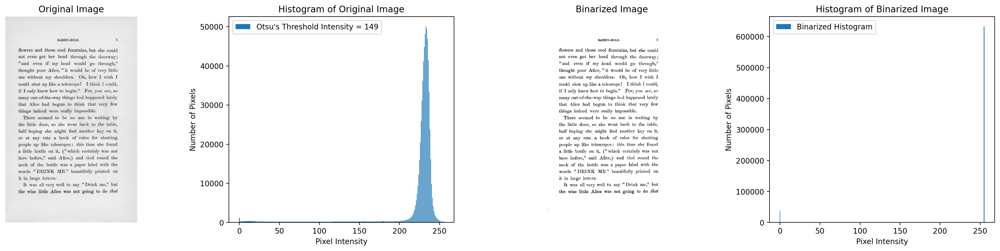

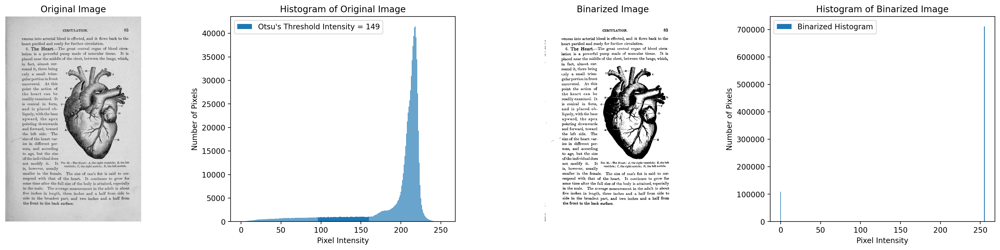

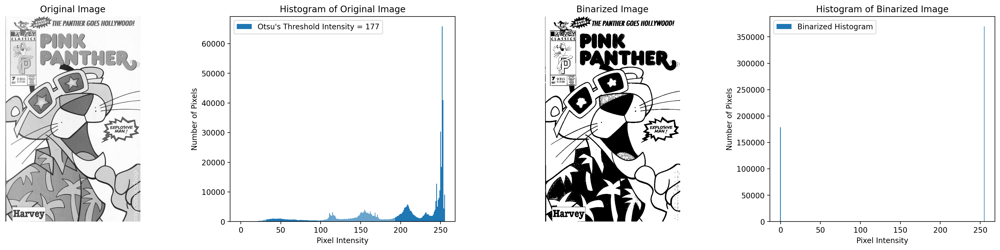

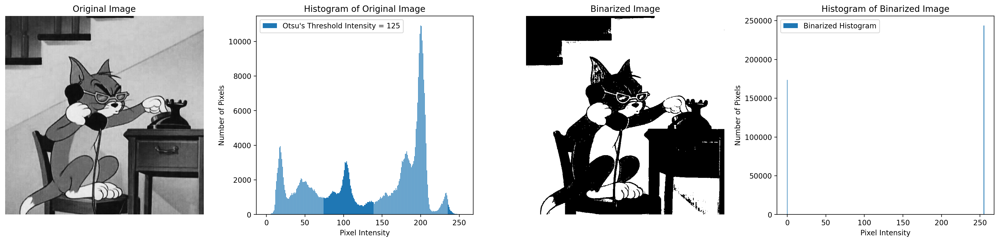

In [8]:
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

plot_binary_image(bookpage_1,"bookpage_1")
plot_binary_image(bookpage_2,"bookpage_2")
plot_binary_image(panther,"panther")
plot_binary_image(tom,"tom")

# Binarization after adding Gaussian Noise to the Images

A random normal (gaussian) array is added to the image array as noise using the np.random.normal function.

In [9]:
# Function defined to add Gaussian noise to the image
def add_gaussian_noise(image,mean,variance):
  height,width=image.shape
  noise=np.random.normal(mean,variance,(height,width))
  noisy_image=image+noise
  noisy_image=np.clip(noisy_image,0,255).astype(np.uint8)
  return noisy_image

# Function defined to plot the binary image with added Gaussian noise
def plot_binary_noisy_image(image, variance_list, mean=0, save_img=True, name='NAME ME'):
  histogram = calculate_histogram(image)
  plot_binary_image(image, name, save_img)
  for i in variance_list:
    noisy_image = add_gaussian_noise(image, mean=mean, variance=i)
    noisy_histogram = calculate_histogram(noisy_image)
    threshold = otsu_threshold(noisy_image)
    binary_image = binarize_image(noisy_image, threshold)
    binary_histogram = calculate_histogram(binary_image)
    if save_img:
      cv2.imwrite(f"./Saved Results/Binarized Image_{name}_var_{i}.png", binary_image)
    plt.figure(figsize=(25, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Noisy Image\nMean = 0, Variance = {i}")
    plt.axis("off")
    plt.subplot(1, 4, 2)
    plot_histogram( noisy_histogram, f"Otsu's Threshold Intensity = {threshold}")
    plt.title("Histogram of Noisy Image")
    plt.subplot(1, 4, 3)
    plt.imshow(cv2.cvtColor(binary_image, cv2.COLOR_BGR2RGB))
    plt.title("Binarized Image")
    plt.axis("off")
    plt.subplot(1, 4, 4)
    plot_histogram(binary_histogram, "Binarized Histogram")
    plt.title("Histogram of Binarized Image")
    plt.show()


In [10]:
mean=0
variance_list=[10,15,100]

### Adding Noise to bookpage_1.jpeg

<IPython.core.display.Javascript object>

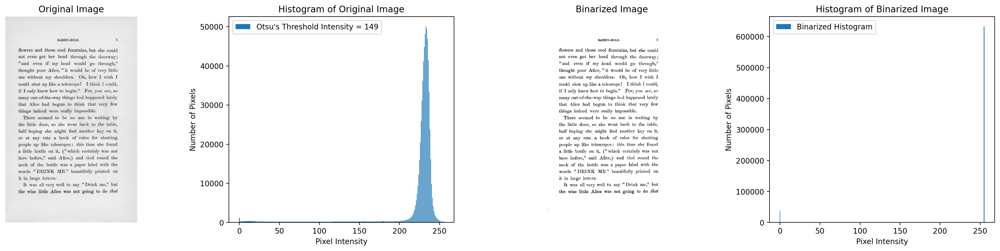

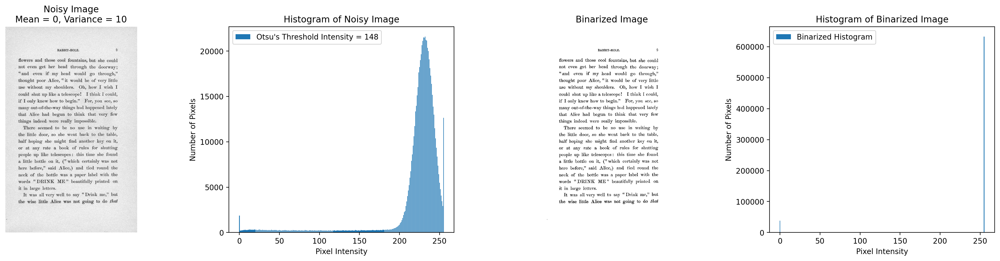

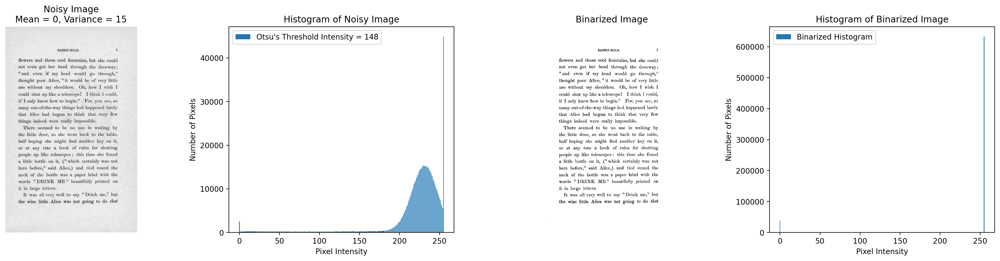

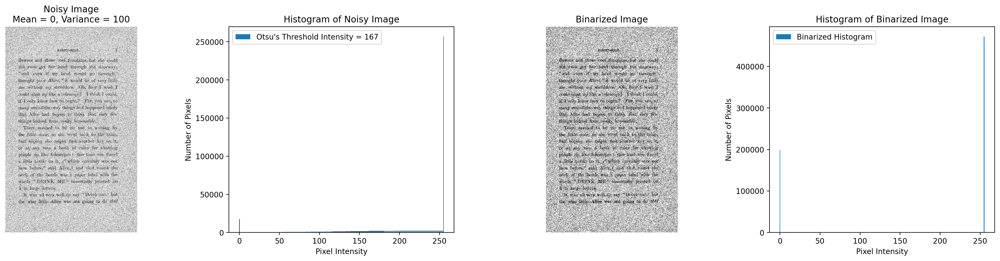

In [11]:
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

plot_binary_noisy_image(bookpage_1, variance_list, mean, True, 'bookpage_1')

### Adding Noise to bookpage_2.jpeg

<IPython.core.display.Javascript object>

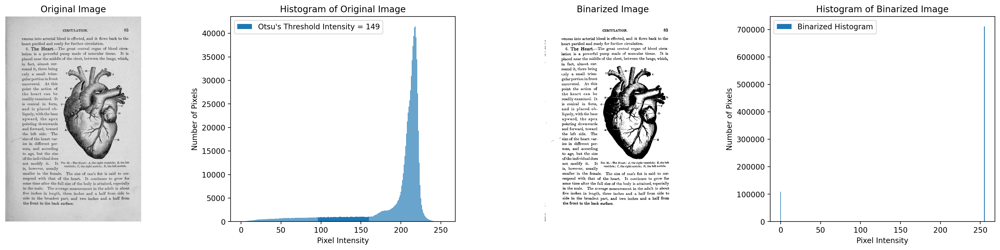

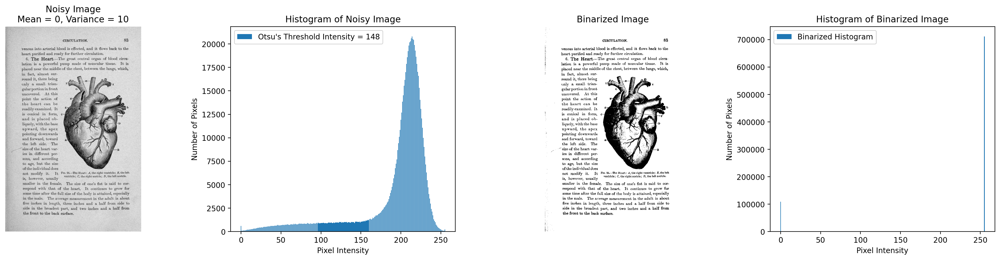

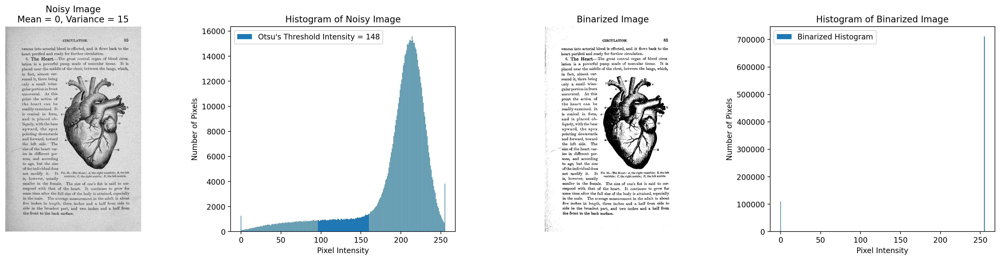

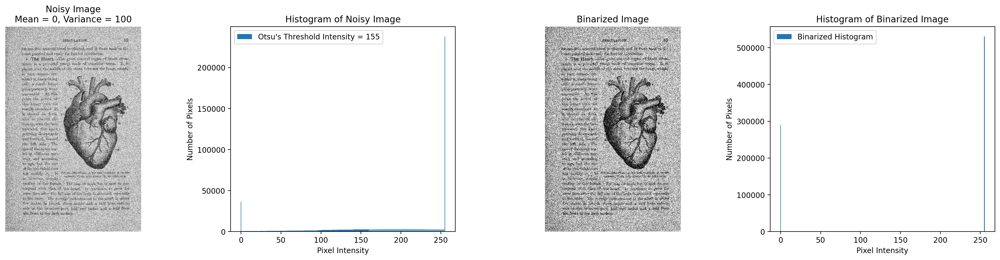

In [12]:
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

plot_binary_noisy_image(bookpage_2, variance_list, mean, True, 'bookpage_2')

### Adding Noise to panther.jpeg

<IPython.core.display.Javascript object>

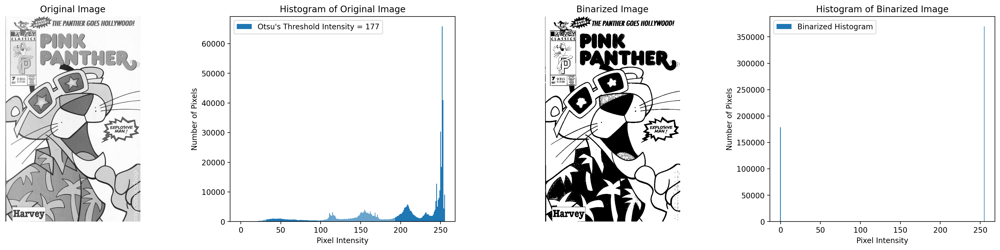

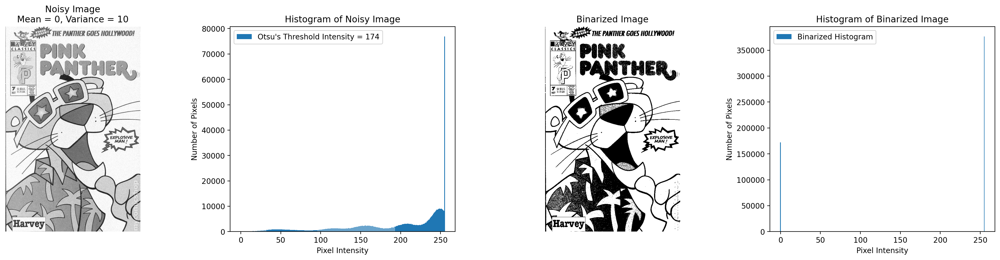

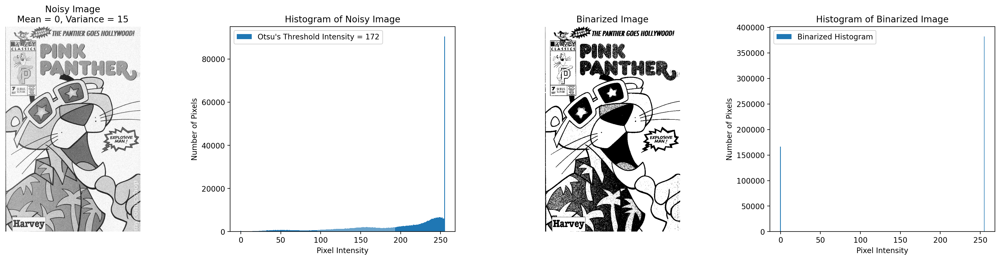

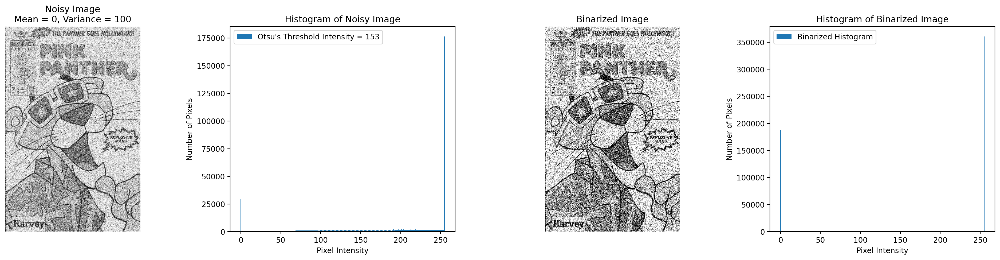

In [13]:
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

plot_binary_noisy_image(panther, variance_list, mean, True, 'panther')

### Adding Noise to tom.jpeg

<IPython.core.display.Javascript object>

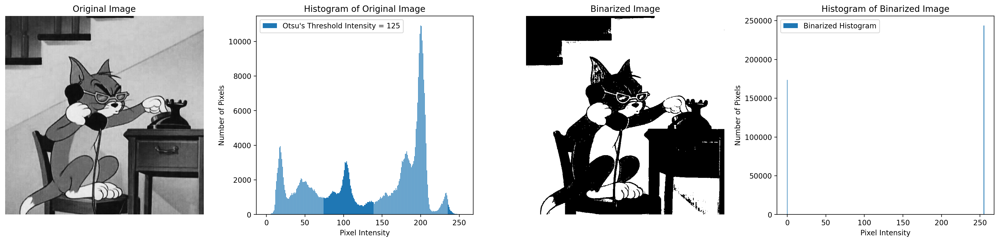

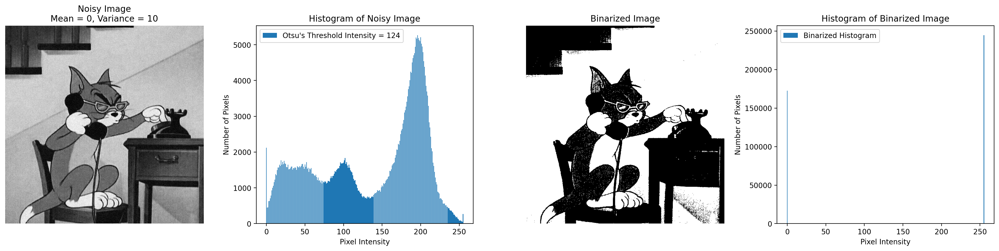

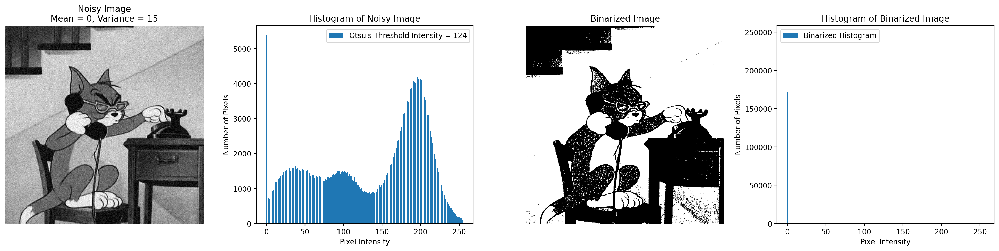

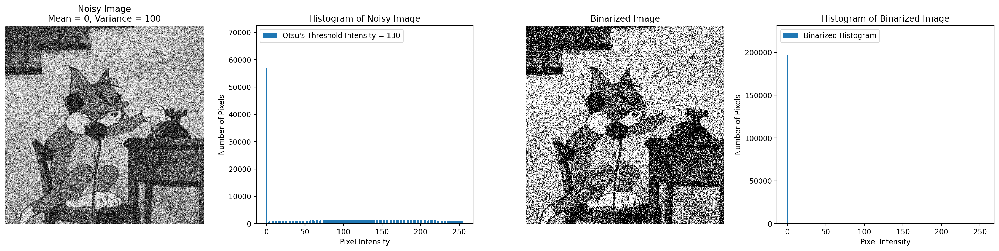

In [14]:
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

plot_binary_noisy_image(tom, variance_list, mean, True, 'tom')

# Observations and Conclusions

1. Given greyscale images were successfully binarized by using Otsu's Thresholding Method.
2. On adding gaussian noise to the given greyscale images and then binarizing them, it was found that the binarized image lost its clarity and detail.
3. Addition of gaussian noise also led to a change in the Otsu's Threshold Intensity of the image.
4. As the variance of the gaussian noise is increased, it was found that the binarized image became furthur blurred.


# Final Results

The final binarized images that were obtained were saved and plotted as follows.

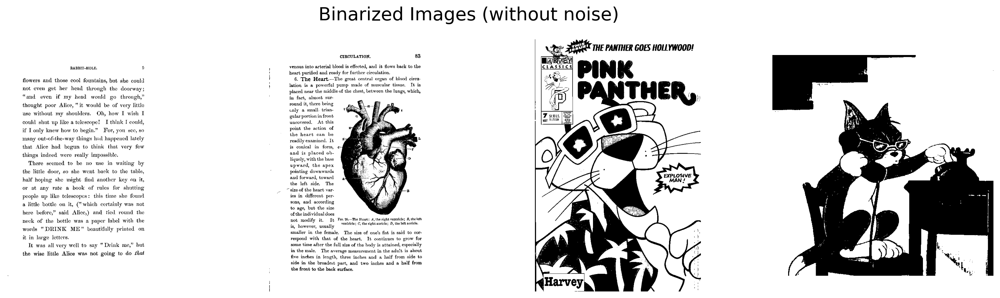

In [15]:
plt.figure(figsize=(20, 5))
plt.suptitle("Binarized Images (without noise)", fontsize=20)
plt.subplot(1,4,1)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Binarized Image_bookpage_1.png"), cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.subplot(1,4,2)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Binarized Image_bookpage_2.png"), cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.subplot(1,4,3)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Binarized Image_panther.png"), cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.subplot(1,4,4)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Binarized Image_tom.png"), cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

<IPython.core.display.Javascript object>

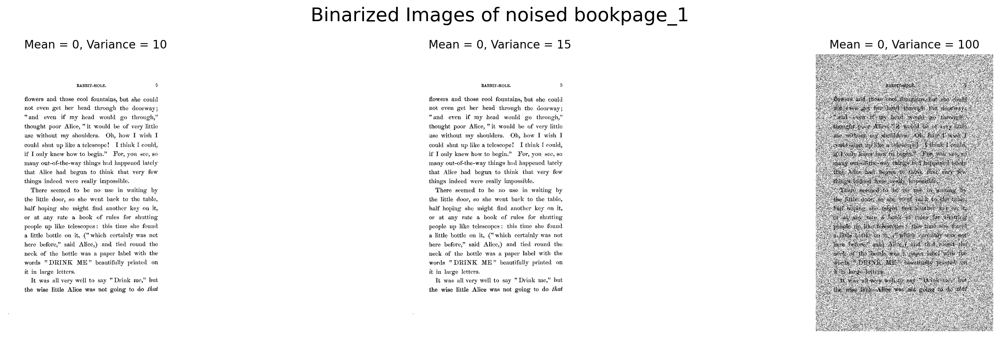

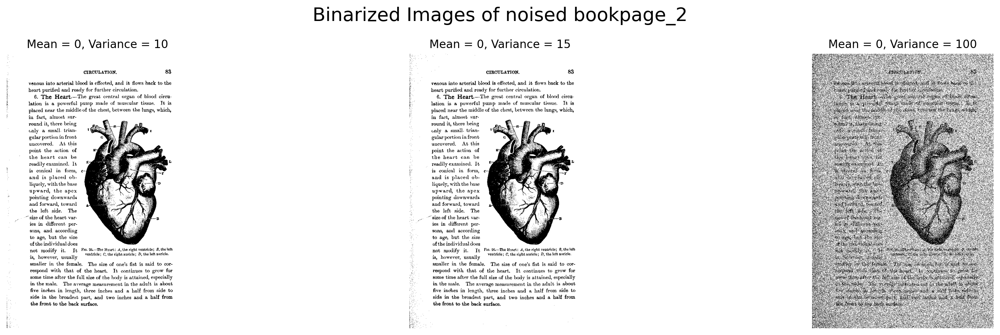

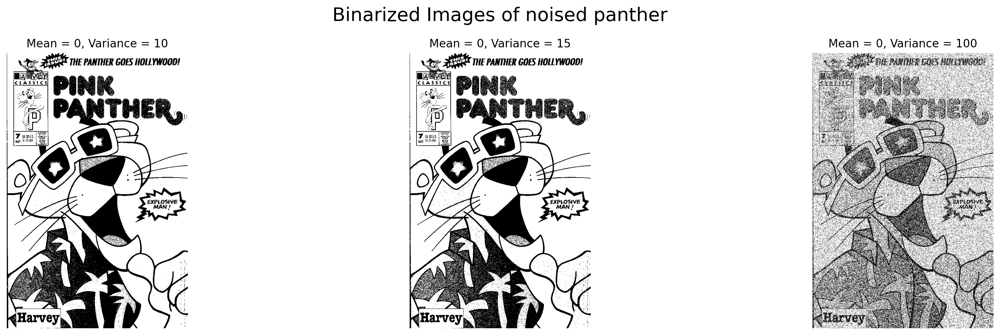

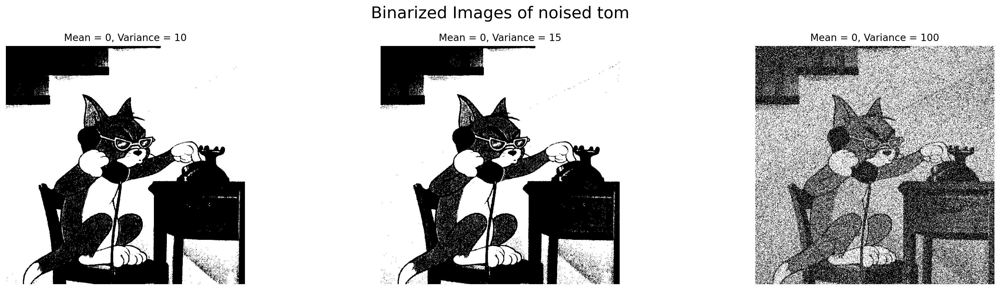

In [16]:
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))


def final_noisy(name,variance_list):
  plt.figure(figsize=(20, 5))
  plt.suptitle(f"Binarized Images of noised {name}", fontsize=20)
  for i in range(len(variance_list)):
    plt.subplot(1,3,i+1)
    plt.imshow(cv2.cvtColor(cv2.imread(f"./Saved Results/Binarized Image_{name}_var_{variance_list[i]}.png"), cv2.COLOR_BGR2RGB))
    plt.title(f"Mean = 0, Variance = {variance_list[i]}")
    plt.axis("off")
  plt.tight_layout()
  plt.show()


final_noisy("bookpage_1",variance_list)
final_noisy("bookpage_2",variance_list)
final_noisy("panther",variance_list)
final_noisy("tom",variance_list)

# **References**

1. Wikipedia Contributors, “Otsu’s method,” Wikipedia, Aug. 16, 2020. https://en.wikipedia.org/wiki/Otsu%27s_method

2. “Otsu’s Thresholding Technique | Learn OpenCV,” Aug. 05, 2020. https://learnopencv.com/otsu-thresholding-with-opencv/

3. OpenCV, “OpenCV: Image Thresholding,” docs.opencv.org. https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html

4. “Disabling auto-scroll of outputs · Issue #541 · googlecolab/colabtools,” GitHub. https://github.com/googlecolab/colabtools/issues/541#issue-440879358 (accessed Mar. 06, 2024).

5. “How to Set a Single Main Title for All the Subplots in Matplotlib?,” GeeksforGeeks, Jan. 02, 2021. https://www.geeksforgeeks.org/how-to-set-a-single-main-title-for-all-the-subplots-in-matplotlib/ (accessed Mar. 04, 2024).

6. Lab Discussion Notes provided in Google Classroom. https://iitgnacin-my.sharepoint.com/:b:/r/personal/19210048_iitgn_ac_in/Documents/Notebooks/Otsu%20Algorithm%20.pdf?csf=1&web=1&e=1a6CAv

7. Discussed the errors in the code and confirmed findings with Karan Gandhi